# Advance Lane Detection Project

### The goals / steps of this project are the following:
##### - Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
##### - Apply a distortion correction to raw images.
##### - Use color transforms, gradients, etc., to create a thresholded binary image.
##### - Apply a perspective transform to rectify binary image ("birds-eye view").
##### - Detect lane pixels and fit to find the lane boundary.
##### - Determine the curvature of the lane and vehicle position with respect to center.
##### - Warp the detected lane boundaries back onto the original image.
##### - Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

### Abstract
###### In the growing domain of the autonomous driving, it is essential to know the lane in which the vehicle is driving and which path is to follow on the roads. This lane line finding techniques is a simple way of approach to detect lines using the image processing technique on videos. The algorithm uses different ways of processing the image at first and using the same as reference for the continuous image processing on video. 

In [1]:
## Import all the relevant python libraries
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline
import glob
import pickle
import math
from moviepy.editor import VideoFileClip
from IPython.display import HTML
%matplotlib qt

In [2]:
''' 
This function is used to display the ouput images in case of multiple images to be displayed. But it is limited to only 
maximum of 4 images.
'''

def display_images(img1=[], img2=[], cmap=None, label1=[], label2=[], img3=[], label3=[], img4=[], label4=[], n=2):
    plt.figure(figsize=(24, 9))
    plt.subplot(1, n, 1)
    plt.imshow(img1, cmap = cmap)
    plt.xlabel(label1, fontsize=20)
    plt.subplot(1, n, 2)
    plt.imshow(img2, cmap = cmap)
    plt.xlabel(label2, fontsize=20)
    if n == 3:
        plt.subplot(1, n, 3)
        plt.imshow(img3, cmap = cmap)
        plt.xlabel(label3, fontsize=20)
    elif n == 4:
        plt.subplot(1, n, 3)
        plt.imshow(img3, cmap = cmap)
        plt.xlabel(label3, fontsize=20)
        plt.subplot(1, n, 4)
        plt.imshow(img4, cmap = cmap)
        plt.xlabel(label4, fontsize=20)

### Camera Calibration

#### First step is to compute the camera calibration matrix and distortion coefficients given a set of chessboard images

In [3]:
#### We will now calculate Object points and image points using the set of images in 'camera_cal' folder
cal_images = glob.glob('camera_cal/*.jpg')

nx, ny = 9, 6

# Arrays to store object points and image points from all the images.
objpoints = []  # 3D points
imgpoints = []  # 2D points
    
objp = np.zeros((nx*ny,3), np.float32)
objp[:,:2] = np.mgrid[0:nx,0:ny].T.reshape(-1, 2)

for file in cal_images:
    img = cv2.imread(file)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)
        ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

### After finding out the Camera matrix and distortion coefficients, lets try to undistort an image 

In [4]:
# This function is for performing the undistortion of the provided image. This needs the Camera matrix, distortion 
# coefficients and the original image as inputs
def cal_undistort(img, mtx, dist):
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist

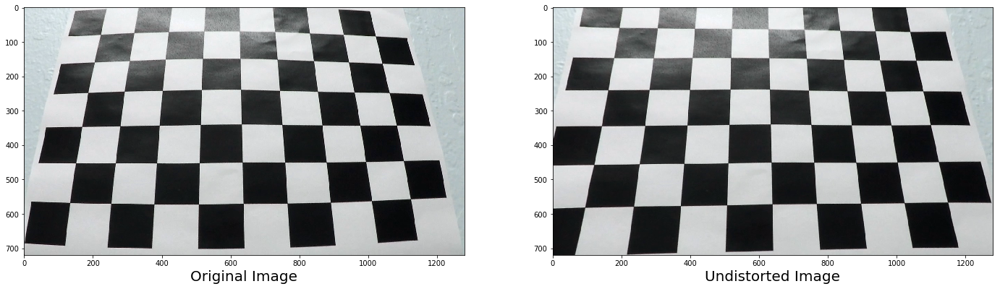

In [5]:
# Lets test the undistortion function on an chess board image and display the outputs
img_chess = cv2.imread(cal_images[6])
img_chessshape = img_chess.shape
undist_chess = cal_undistort(img_chess, mtx, dist)
display_images(img1=img_chess, img2=undist_chess, cmap = None, label1='Original Image', label2='Undistorted Image', n=2)

### Lets try the camera calibration and undistortion on an road image with lanes

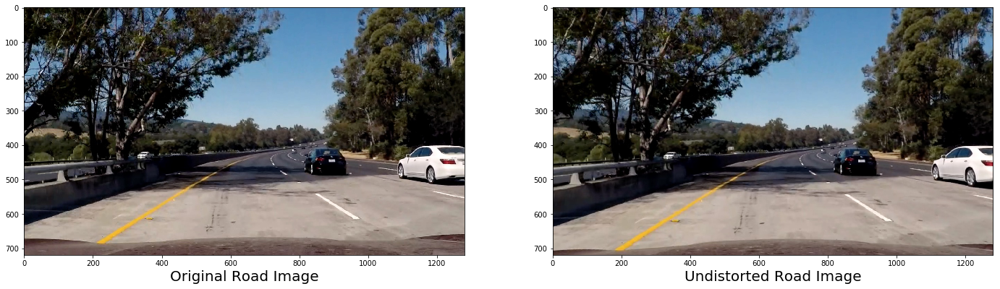

In [6]:
test_images = glob.glob('test_images/*.jpg')
# Read in an image
img_road = cv2.imread(test_images[6])
img_road = cv2.cvtColor(img_road,cv2.COLOR_BGR2RGB)
img_roadshape = img_road.shape
undist_road = cal_undistort(img_road, mtx, dist)
#display_outputs(img_road, undist_road, cmap = 'gray', Org_text = 'Original Road Image', Out_text = 'Undistorted Road Image')
display_images(img1=img_road, img2=undist_road, cmap = None, label1='Original Road Image', label2='Undistorted Road Image', n=2)

## Using the undistorted image, we now perform a perspective transform 
### we will be now performing the following steps
#### - Define 4 source points 
#### - Define 4 destination points 
#### - Use cv2.getPerspectiveTransform() to get M, the transform matrix
#### - use cv2.warpPerspective() to apply M and warp your image to a top-down view

In [7]:
# This is a function to perform the perspective transform of the image
def perspective_transform(img):
    img_shape = img.shape
    img_size = (img_shape[1], img_shape[0])
    # Providing default source and destination points on the image
    # Define the region of interest
    #src = np.float32([[190, 700], [1110, 700], [780, 470], [570, 470]])
    #dst = np.float32([[200, 700], [1050, 700], [1050, 1], [320, 1]])
    src = np.float32([[(img_size[0] / 2) - 55, img_size[1] / 2 + 100],
         [((img_size[0] / 6) - 10), img_size[1]],
         [(img_size[0] * 5 / 6) + 60, img_size[1]],
         [(img_size[0] / 2 + 55), img_size[1] / 2 + 100]])
    dst = np.float32([[(img_size[0] / 4), 0],
         [(img_size[0] / 4), img_size[1]],
         [(img_size[0] * 3 / 4), img_size[1]],
         [(img_size[0] * 3 / 4), 0]])
    #undist_img= cal_undistort(img, mtx, dist)
    M = cv2.getPerspectiveTransform(src, dst)
    warped = cv2.warpPerspective(img , M, img_size, flags=cv2.INTER_LINEAR)
    return warped

def inv_perspective_transform(img):
    img_shape = img.shape
    img_size = (img_shape[1], img_shape[0])
    # Providing default source and destination points on the image
    # Define the region of interest
    #src = np.float32([[190, 700], [1110, 700], [780, 470], [570, 470]])
    #dst = np.float32([[200, 700], [1050, 700], [1050, 1], [320, 1]])
    src = np.float32([[(img_size[0] / 2) - 55, img_size[1] / 2 + 100],
         [((img_size[0] / 6) - 10), img_size[1]],
         [(img_size[0] * 5 / 6) + 60, img_size[1]],
         [(img_size[0] / 2 + 55), img_size[1] / 2 + 100]])
    dst = np.float32([[(img_size[0] / 4), 0],
         [(img_size[0] / 4), img_size[1]],
         [(img_size[0] * 3 / 4), img_size[1]],
         [(img_size[0] * 3 / 4), 0]])
    img_shape = img.shape
    img_size = (img_shape[1], img_shape[0])
    M_inv = cv2.getPerspectiveTransform(dst, src)
    warped = cv2.warpPerspective(img , M_inv, img_size, flags=cv2.INTER_LINEAR)
    return warped

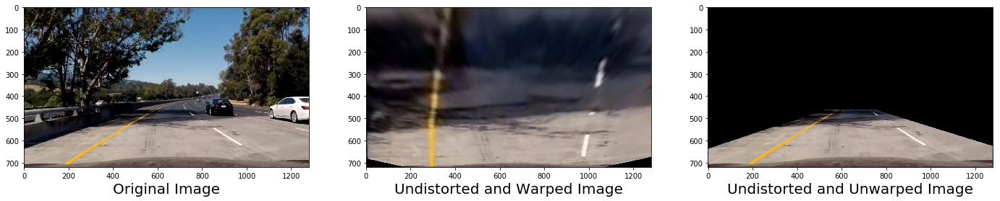

In [8]:
# to check how the warped and unwarp work with the perspective transform functions
warped = perspective_transform(undist_road)
unwarped = inv_perspective_transform(warped)
display_images(img1=undist_road, img2=warped, cmap= None, label1='Original Image', label2='Undistorted and Warped Image', \
                   img3=unwarped, label3='Undistorted and Unwarped Image', n=3)

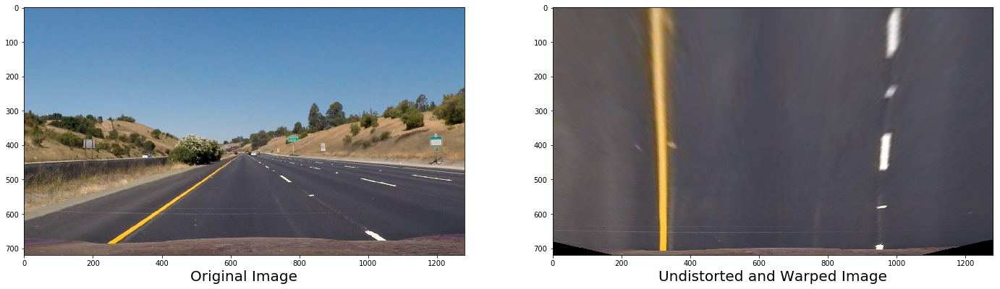

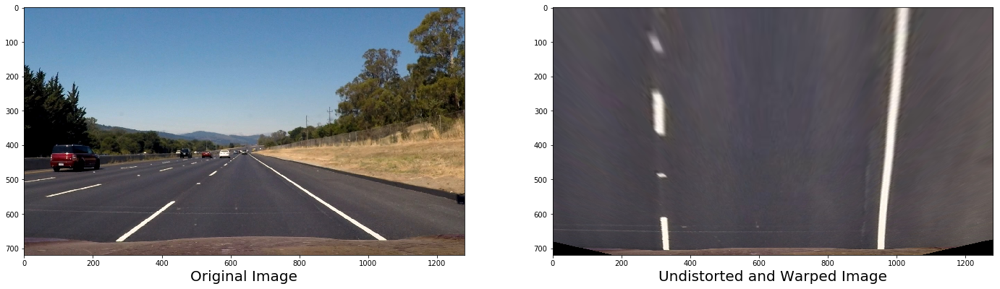

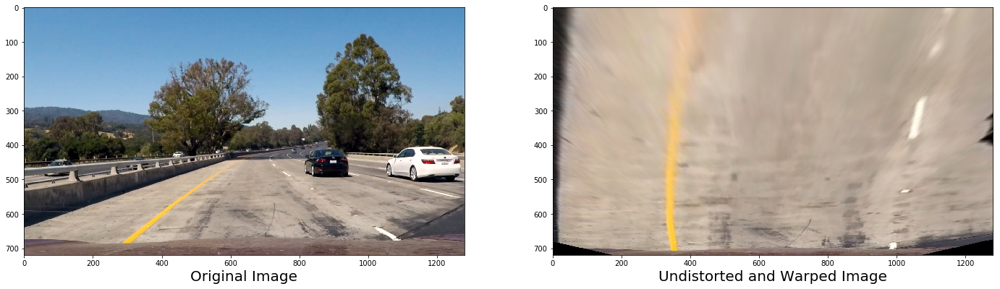

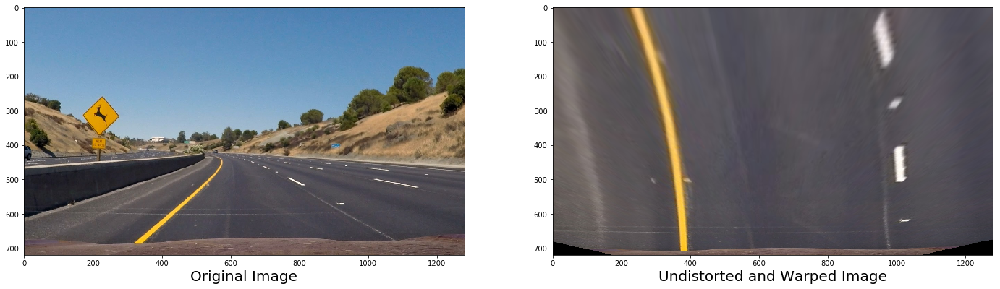

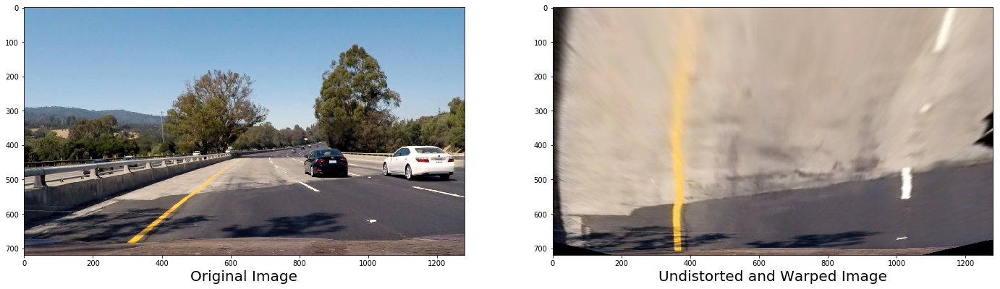

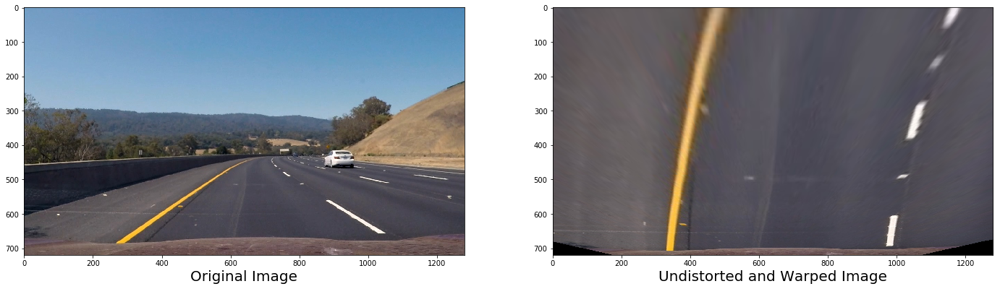

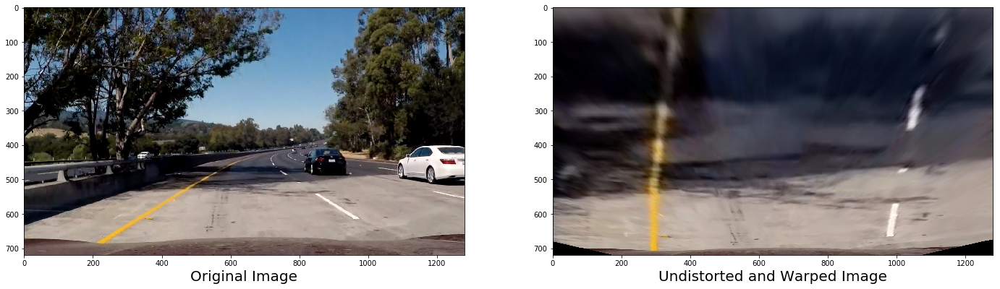

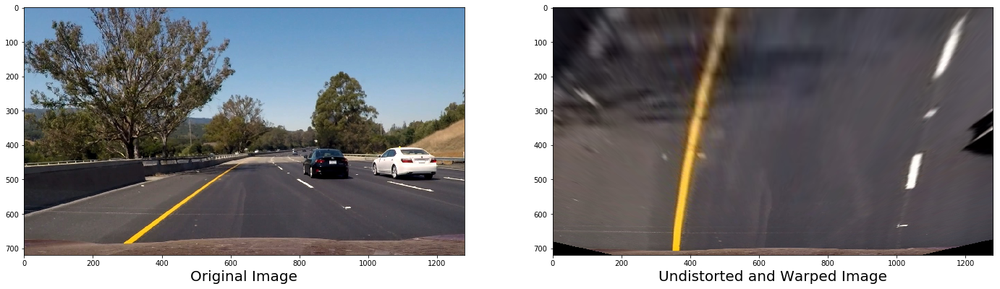

In [9]:
test_images = glob.glob('test_images/*.jpg')
for file in test_images:
    img = cv2.imread(file)
    img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
    warped = perspective_transform(img)
    # to write the output processed image
    cv2.imwrite("test_image_output/output_"+file, warped)
    display_images(img1=img, img2=warped, cmap = None, label1='Original Image', label2='Undistorted and Warped Image', n=2)

In [10]:
def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):
    # Calculate directional gradient
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Apply threshold
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel))
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    sobel_output = np.zeros_like(scaled_sobel)
    # Here we will be using using inclusive (>=, <=) thresholds, but exclusive is ok too
    sobel_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    return sobel_output

In [11]:
# Define a function to return the magnitude of the gradient
# for a given sobel kernel size and threshold values
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # Create a binary image of ones where threshold is met, zeros otherwise
    magthresh_output = np.zeros_like(gradmag)
    magthresh_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1

    # Return the result image
    return magthresh_output


In [12]:
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction, 
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    dirthresh_output =  np.zeros_like(absgraddir)
    dirthresh_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1

    # Return the result image
    return dirthresh_output

In [13]:
def combine_threshold(image, sobel_kernel=3):
    ksize = sobel_kernel # Choose a larger odd number to smooth gradient measurements

    # Apply each of the thresholding functions
    gradx = abs_sobel_thresh(image, orient='x', sobel_kernel=ksize, thresh=(20, 70))
    grady = abs_sobel_thresh(image, orient='y', sobel_kernel=ksize, thresh=(20, 70))
    mag_binary = mag_thresh(image, sobel_kernel=ksize, mag_thresh=(30, 100))
    dir_binary = dir_threshold(image, sobel_kernel=ksize, thresh=(0.7, 1.3))
    combined_thresh = np.zeros_like(dir_binary)
    combined_thresh[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    
    #return the result image
    return combined_thresh

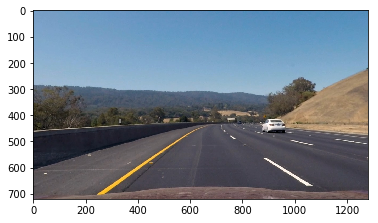

In [14]:

test_images = glob.glob('test_images/*.jpg')
# Read in an image
img_road = cv2.imread(test_images[5])
img_road = cv2.cvtColor(img_road, cv2.COLOR_BGR2RGB)
img_undist_road = cal_undistort(img_road, mtx, dist)
plt.imshow(img_undist_road)

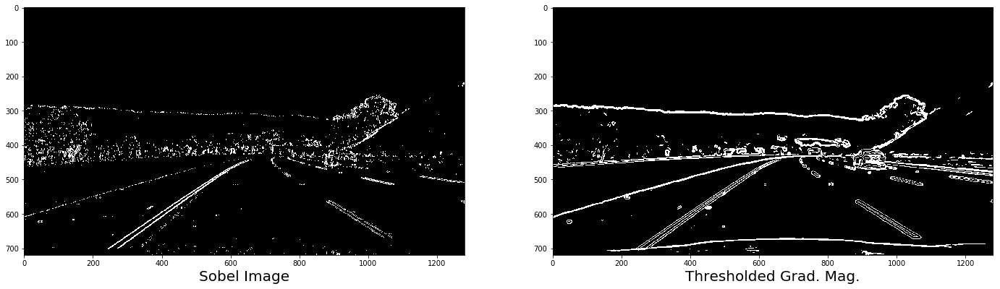

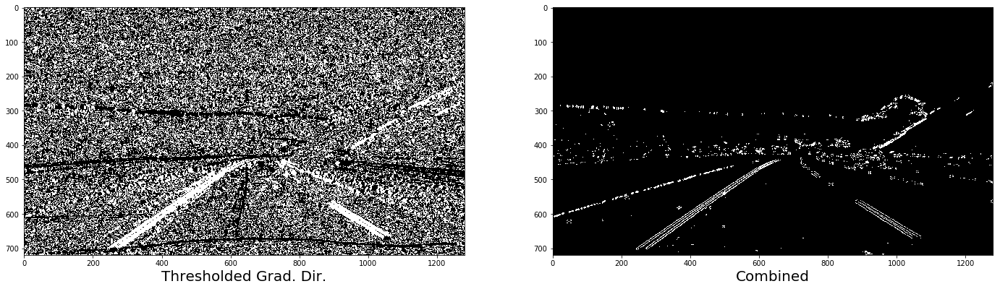

In [15]:

sobelimg = abs_sobel_thresh(img_undist_road, orient='x',sobel_kernel=3, thresh=(20, 100))
magimg = mag_thresh(img_undist_road, sobel_kernel=15, mag_thresh=(30, 100))
dirimg = dir_threshold(img_undist_road, sobel_kernel=15, thresh=(0.7, 1.3))
combimg = combine_threshold(img_undist_road, sobel_kernel=15)
display_images(img1=sobelimg, img2=magimg, cmap='gray', label1='Sobel Image', label2='Thresholded Grad. Mag.', n=2)
display_images(img1=dirimg, img2=combimg, cmap='gray', label1='Thresholded Grad. Dir.', label2='Combined', n=2)

In [16]:
def gray_process_img(img, thresh =(180,255)):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    Graybinary = np.zeros_like(gray)
    Graybinary[(gray > thresh[0]) & (gray <= thresh[1])] = 1
    return Graybinary, gray

def RGB_process_img(image, channel='r', thresh =(200,255)):
    R = image[:,:,0]
    G = image[:,:,1]
    B = image[:,:,2]
    if channel == 'r':
        RGBbinary = np.zeros_like(R)
        RGBbinary[(R > thresh[0]) & (R <= thresh[1])] = 1
    if channel == 'g':
        RGBbinary = np.zeros_like(G)
        RGBbinary[(G > thresh[0]) & (G <= thresh[1])] = 1
    if channel == 'b':
        RGBbinary = np.zeros_like(B)
        RGBbinary[(B > thresh[0]) & (B <= thresh[1])] = 1
    return RGBbinary, R, G, B

def HLS_process_img(image, channel='h', thresh =(200,255)):
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    H = hls[:,:,0]
    L = hls[:,:,1]
    S = hls[:,:,2]
    if channel == 'h':
        HLSbinary = np.zeros_like(H)
        HLSbinary[(H > thresh[0]) & (H <= thresh[1])] = 1
    if channel == 'l':
        HLSbinary = np.zeros_like(L)
        HLSbinary[(L > thresh[0]) & (L <= thresh[1])] = 1
    if channel == 's':
        HLSbinary = np.zeros_like(S)
        HLSbinary[(S > thresh[0]) & (S <= thresh[1])] = 1  
    return HLSbinary, H, L, S

def LAB_process_img(image, channel='l', thresh =(200,255)):
    lab = cv2.cvtColor(image, cv2.COLOR_RGB2LAB)
    L = lab[:,:,0]
    A = lab[:,:,1]
    B = lab[:,:,2]
    if channel == 'l':
        LABbinary = np.zeros_like(L)
        LABbinary[(L > thresh[0]) & (L <= thresh[1])] = 1
    if channel == 'a':
        LABbinary = np.zeros_like(A)
        LABbinary[(A > thresh[0]) & (A <= thresh[1])] = 1
    if channel == 'b':
        LABbinary = np.zeros_like(B)
        LABbinary[(B > thresh[0]) & (B <= thresh[1])] = 1  
    return LABbinary, L, A, B

def LUV_process_img(image, channel='l', thresh =(200,255)):
    luv = cv2.cvtColor(image, cv2.COLOR_RGB2LUV)
    L = luv[:,:,0]
    U = luv[:,:,1]
    V = luv[:,:,2]
    if channel == 'l':
        LUVbinary = np.zeros_like(L)
        LUVbinary[(L > thresh[0]) & (L <= thresh[1])] = 1
    if channel == 'u':
        LUVbinary = np.zeros_like(U)
        LUVbinary[(U > thresh[0]) & (U <= thresh[1])] = 1
    if channel == 'v':
        LUVbinary = np.zeros_like(V)
        LUVbinary[(V > thresh[0]) & (V <= thresh[1])] = 1  
    return LUVbinary, L, U, V

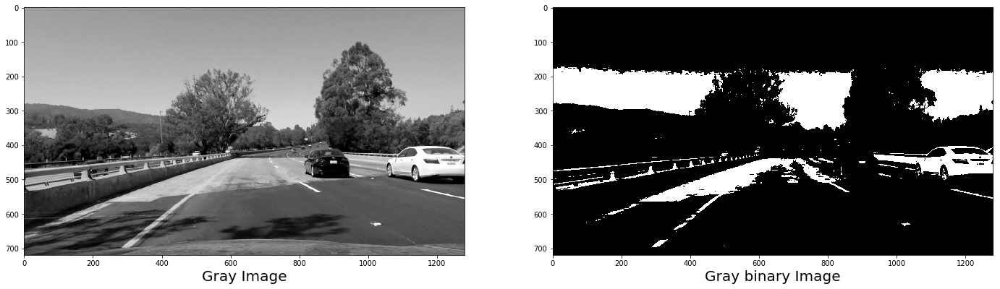

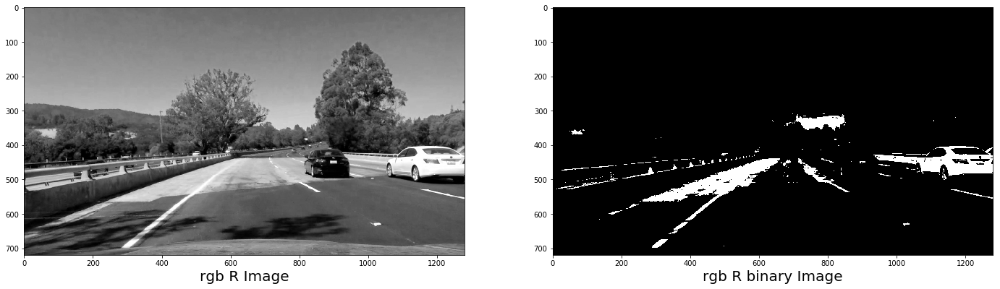

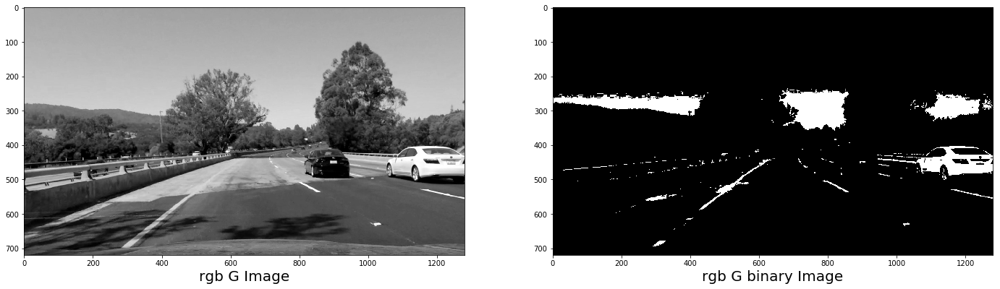

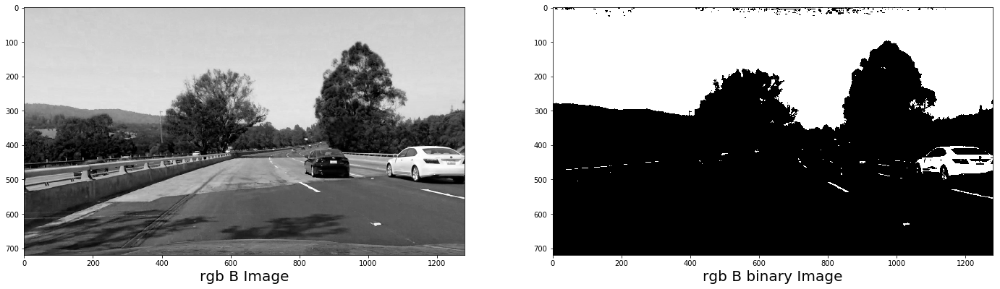

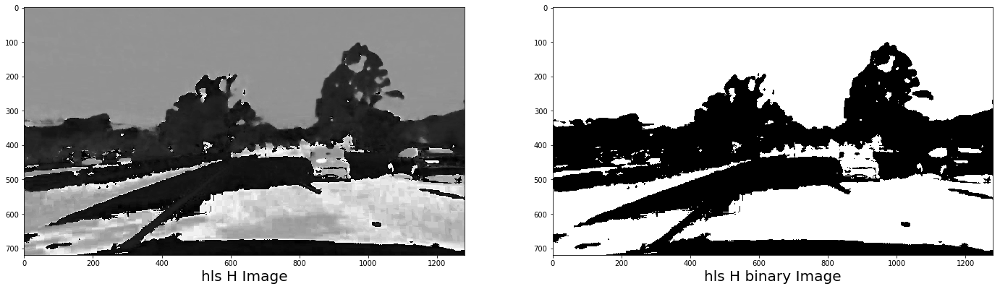

...

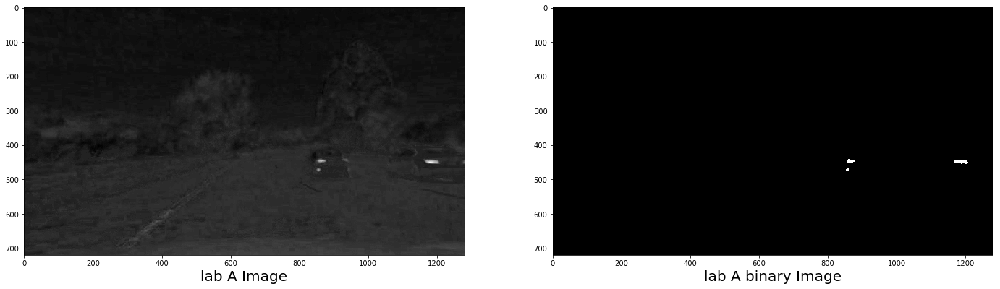

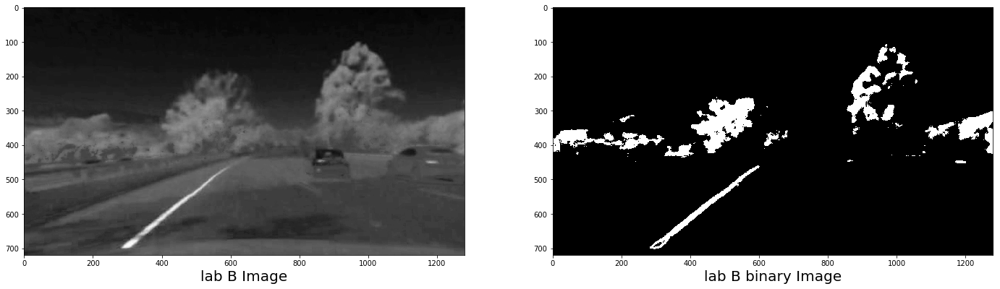

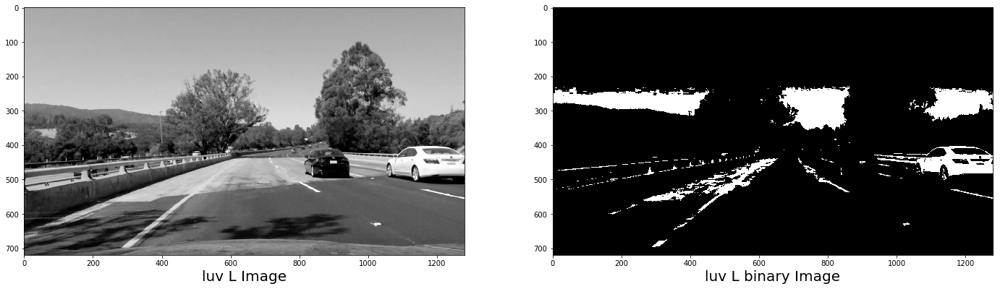

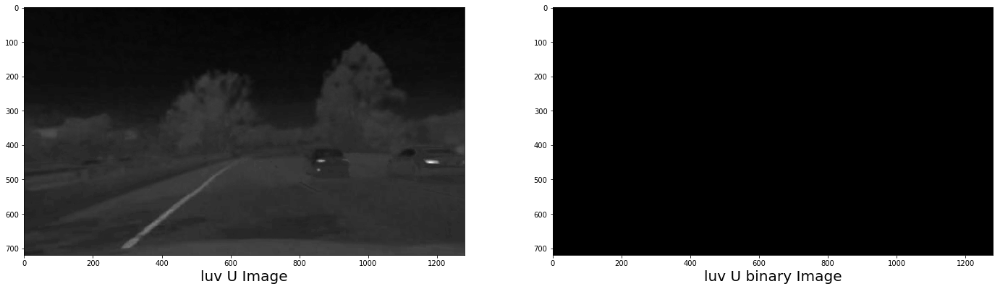

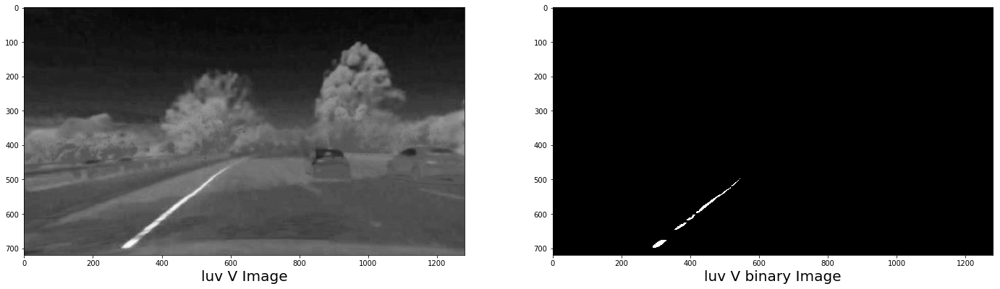

In [17]:
test_images = glob.glob('test_images/*.jpg')
# Read in an image
img_road = cv2.imread(test_images[4])
img_road = cv2.cvtColor(img_road, cv2.COLOR_BGR2RGB)
img_road = cal_undistort(img_road, mtx, dist)

grayimg, gray = gray_process_img(img_road, thresh =(180,255))
display_images(img1=gray, img2=grayimg, cmap='gray', label1='Gray Image', label2='Gray binary Image', n=2)

#### RGB Binary
rgb_R_img, R, G, B = RGB_process_img(img_road, channel='r', thresh =(200,255))
display_images(img1=R, img2=rgb_R_img, cmap='gray', label1='rgb R Image', label2='rgb R binary Image', n=2)

rgb_G_img, R, G, B = RGB_process_img(img_road, channel='g', thresh =(200,255))
display_images(img1=G, img2=rgb_G_img, cmap='gray', label1='rgb G Image', label2='rgb G binary Image', n=2)

rgb_B_img, R, G, B= RGB_process_img(img_road, channel='b', thresh =(200,255))
display_images(img1=B, img2=rgb_B_img, cmap='gray', label1='rgb B Image', label2='rgb B binary Image', n=2)

#### HLS Binary
hls_H_img, H, L, S = HLS_process_img(img_road, channel='h', thresh =(90,255))
display_images(img1=H, img2=hls_H_img, cmap='gray', label1='hls H Image', label2='hls H binary Image', n=2)

hls_L_img, H, L, S  = HLS_process_img(img_road, channel='l', thresh =(90,255))
display_images(img1=L, img2=hls_L_img, cmap='gray', label1='hls L Image', label2='hls L binary Image', n=2)

hls_S_img, H, L, S = HLS_process_img(img_road, channel='s', thresh =(90,255))
display_images(img1=S, img2=hls_S_img, cmap='gray', label1='hls S Image', label2='hls S binary Image', n=2)

#### LAB Binary
lab_L_img, L, A, B = LAB_process_img(img_road, channel='l', thresh =(145,200))
display_images(img1=L, img2=lab_L_img, cmap='gray', label1='lab L Image', label2='lab L binary Image', n=2)

lab_A_img, L, A, B  = LAB_process_img(img_road, channel='a', thresh =(145,200))
display_images(img1=A, img2=lab_A_img, cmap='gray', label1='lab A Image', label2='lab A binary Image', n=2)

lab_B_img, L, A, B = LAB_process_img(img_road, channel='b', thresh =(145,200))
display_images(img1=B, img2=lab_B_img, cmap='gray', label1='lab B Image', label2='lab B binary Image', n=2)

#### LUV Binary
luv_L_img, L, U, V = LUV_process_img(img_road, channel='l', thresh =(200,255))
display_images(img1=L, img2=luv_L_img, cmap='gray', label1='luv L Image', label2='luv L binary Image', n=2)

luv_U_img, L, U, V  = LUV_process_img(img_road, channel='u', thresh =(200,255))
display_images(img1=U, img2=luv_U_img, cmap='gray', label1='luv U Image', label2='luv U binary Image', n=2)

luv_V_img, L, U, V = LUV_process_img(img_road, channel='v', thresh =(200,255))
display_images(img1=V, img2=luv_V_img, cmap='gray', label1='luv V Image', label2='luv V binary Image', n=2)

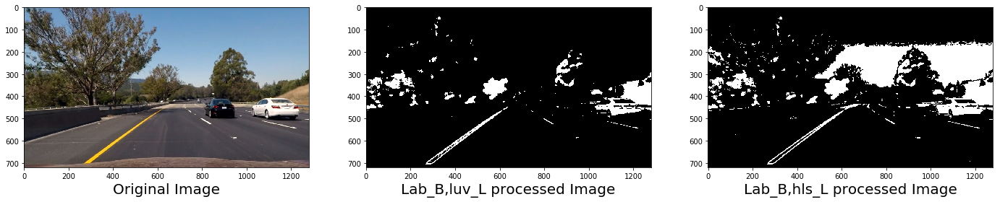

In [18]:
def color_threshold_pipetest(img):
    img = np.copy(img)
    
    
    rgb_R_img, R, G, B = RGB_process_img(img_road, channel='r', thresh =(200,255))
    
    lab_B_img, L, A, B = LAB_process_img(img_road, channel='b', thresh =(145,200))
    luv_L_img, L, U, V = LUV_process_img(img_road, channel='l', thresh =(215,255))
    
    color_1 = np.dstack(( np.zeros_like(luv_L_img), luv_L_img, lab_B_img)) * 255
    combined_1 = np.zeros_like(luv_L_img)
    combined_1[(luv_L_img == 1) | (lab_B_img == 1)] = 1
    
    sobelimg = abs_sobel_thresh(img, orient='x',sobel_kernel=3, thresh=(170, 255))
    S_img, H, L, S = HLS_process_img(img, channel='s', thresh =(20, 100))
    
    color_2 = np.dstack(( np.zeros_like(sobelimg), sobelimg, S_img)) * 255
    combined_2 = np.zeros_like(sobelimg)
    combined_2[(S_img == 1) | (sobelimg == 1)] = 1
    
    L_img, H, L, S = HLS_process_img(img, channel='l', thresh =(170, 255))

    color_3 = np.dstack(( np.zeros_like(lab_B_img), lab_B_img, L_img)) * 255
    combined_3 = np.zeros_like(lab_B_img)
    combined_3[(L_img == 1) | (lab_B_img == 1)] = 1
    return combined_3, combined_1

img_road = cv2.imread(test_images[7])
img_road = cv2.cvtColor(img_road, cv2.COLOR_BGR2RGB)
img_road = cal_undistort(img_road, mtx, dist)

combined_3, combined_1 = color_threshold_pipetest(img_road)
display_images(img1=img_road, img2=combined_1, cmap='gray', label1='Original Image', label2='Lab_B,luv_L processed Image',\
                   img3=combined_3, label3='Lab_B,hls_L processed Image', n=3)

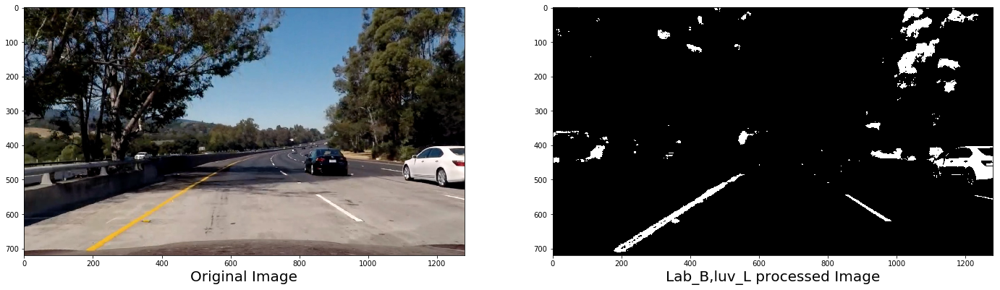

In [19]:
def color_threshold_pipe(img):
    img = np.copy(img)
    
    lab_B_img, L, A, B = LAB_process_img(img, channel='b', thresh =(145,200))
    luv_L_img, L, U, V = LUV_process_img(img, channel='l', thresh =(215,255))
    
    color_binary = np.dstack(( np.zeros_like(lab_B_img), lab_B_img, luv_L_img)) * 255
    combined_binary = np.zeros_like(lab_B_img)
    combined_binary[(luv_L_img == 1) | (lab_B_img == 1)] = 1
    
    return combined_binary

img_road = cv2.imread(test_images[6])
img_road = cv2.cvtColor(img_road, cv2.COLOR_BGR2RGB)
img_road = cal_undistort(img_road, mtx, dist)

combined_binary = color_threshold_pipe(img_road)
display_images(img1=img_road, img2=combined_binary, cmap='gray', label1='Original Image', label2='Lab_B,luv_L processed Image', n=2)

In [20]:
def color_gradient_pipe(img, s_thresh=(170, 255), sx_thresh=(20, 100)):
    img = np.copy(img)
    
    sobelimg = abs_sobel_thresh(img, orient='x',sobel_kernel=3, thresh=sx_thresh)
    
    S_img, H, L, S = HLS_process_img(img, channel='s', thresh =s_thresh)
    
    color_binary = np.dstack(( np.zeros_like(sobelimg), sobelimg, S_img)) * 255
    combined_binary = np.zeros_like(sobelimg)
    combined_binary[(S_img == 1) | (sobelimg == 1)] = 1
    return combined_binary

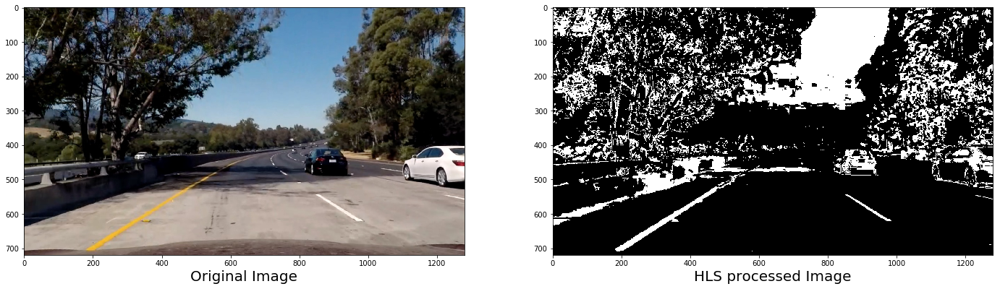

In [21]:
img_road = cv2.imread(test_images[6])
img_road = cv2.cvtColor(img_road, cv2.COLOR_BGR2RGB)
img_road = cal_undistort(img_road, mtx, dist)

ColorGradientImg = color_gradient_pipe(img_road, s_thresh=(100, 255), sx_thresh=(100, 255))
display_images(img1=img_road, img2=ColorGradientImg, cmap='gray', label1='Original Image', label2='HLS processed Image', n=2)

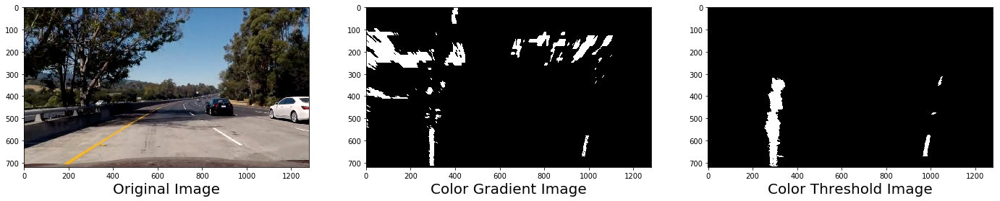

In [22]:
# testing the same filtering and also performing perspective transform
img_road = cv2.imread(test_images[6])
img_road = cv2.cvtColor(img_road, cv2.COLOR_BGR2RGB)
img_road = cal_undistort(img_road, mtx, dist)
ColorGradientImg = color_gradient_pipe(img_road, s_thresh=(150, 255), sx_thresh=(90, 100))
ColorThreshImg = color_threshold_pipe(img_road)
WarpedGradImg = perspective_transform(ColorGradientImg)
WarpedThresImg = perspective_transform(ColorThreshImg)

display_images(img1=img_road, img2=WarpedGradImg, cmap='gray', label1='Original Image', label2='Color Gradient Image',\
                   img3=WarpedThresImg, label3='Color Threshold Image', n=3)

## Now lets create a pipeline which does all these process together and provides us the color and threshold processed and perspective transformed image

In [23]:
def Image_process_pipeline(image):
    image = cal_undistort(image, mtx, dist)
    ColorThreshImg = color_threshold_pipe(image)
    WarpedImg = perspective_transform(ColorThreshImg)
    return WarpedImg

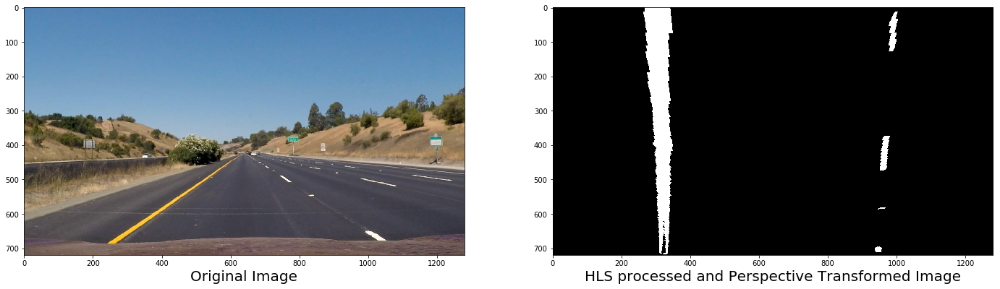

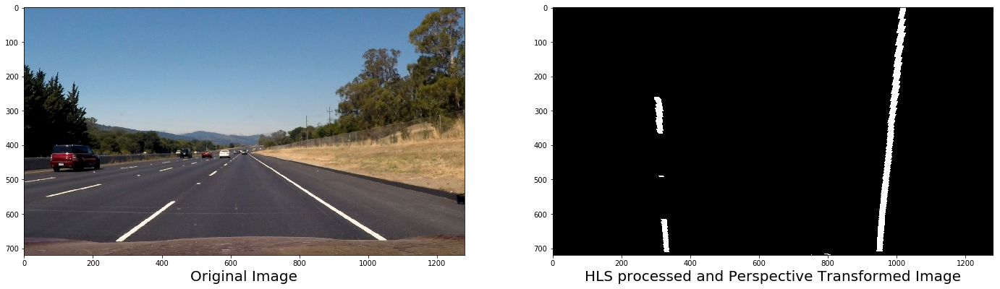

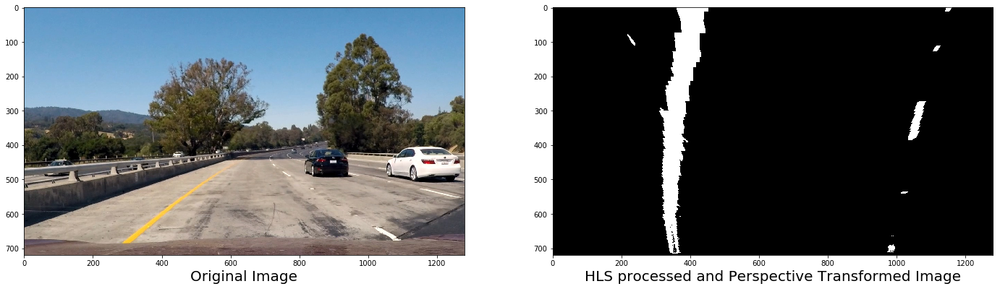

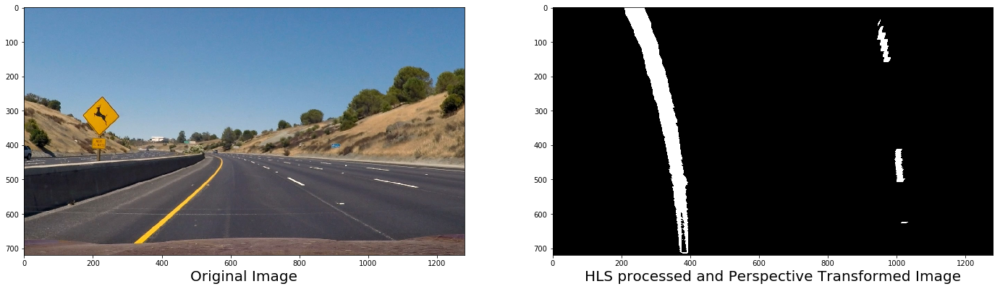

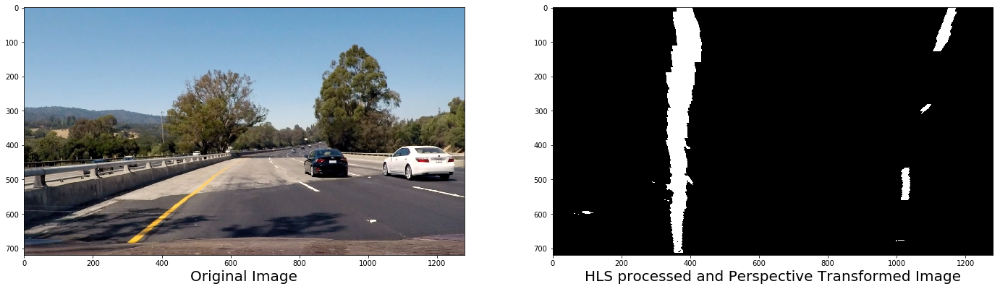

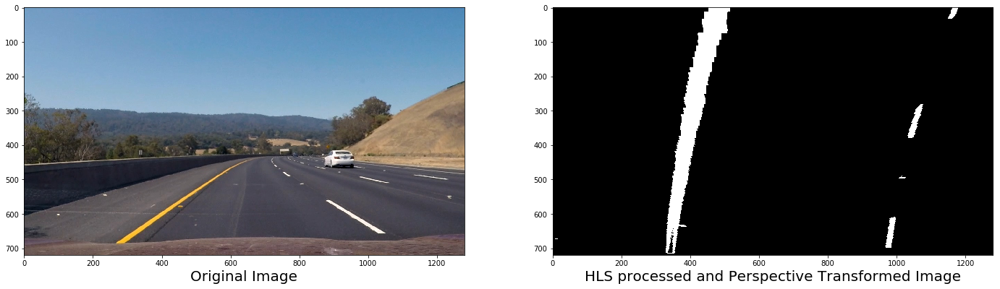

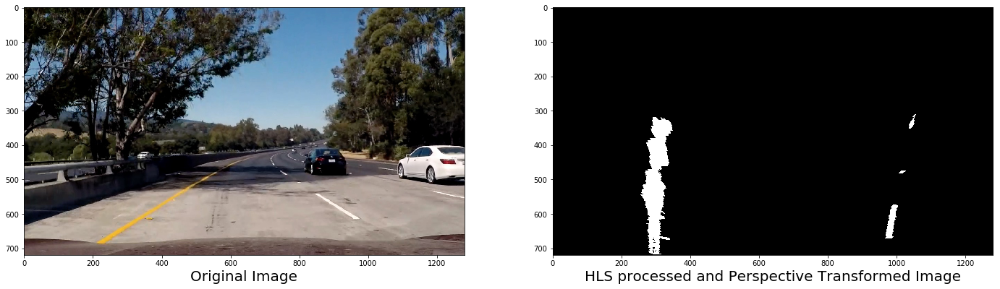

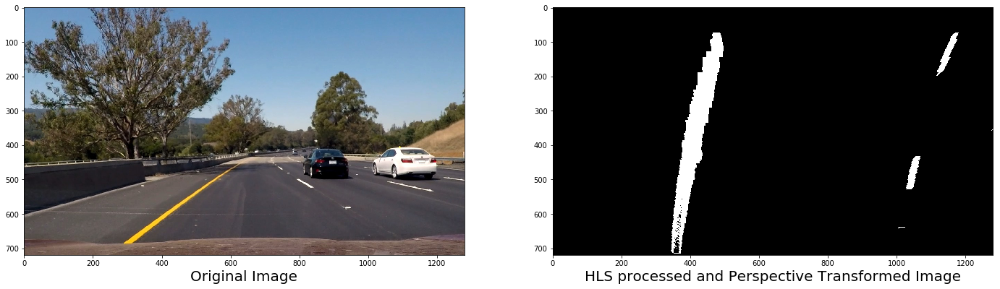

In [24]:
test_images = glob.glob('test_images/*.jpg')
for file in test_images:
    img_road = cv2.imread(file)
    img_road = cv2.cvtColor(img_road, cv2.COLOR_BGR2RGB)
    ImgProcessWarped = Image_process_pipeline(img_road)
    display_images(img1=img_road, img2=ImgProcessWarped, cmap='gray', label1='Original Image', label2='HLS processed and Perspective Transformed Image', n=2)

## Now we proceed further to find the peaks in a Histogram
#### This is an important step in the lane finding method. 

360.0


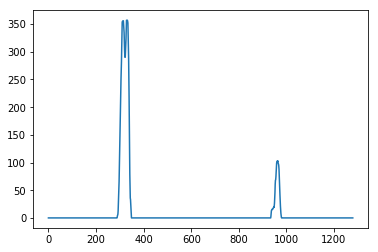

In [25]:
def hist(img):
    # Grab only the bottom half of the image
 
    # Lane lines are likely to be mostly vertical nearest to the car
    bottom_half = img[img.shape[0]//2:,:]
    print(img.shape[0]/2)
    # TO-DO: Sum across image pixels vertically - make sure to set `axis`
    # i.e. the highest areas of vertical lines should be larger values
    histogram = np.sum(bottom_half, axis=0)
    #histogram = None
    
    return histogram
img_road = cv2.imread(test_images[0])
img_road = cv2.cvtColor(img_road, cv2.COLOR_BGR2RGB)
ImgProcessWarped = Image_process_pipeline(img_road)
histogram = hist(ImgProcessWarped)
# Visualize the resulting histogram
plt.plot(histogram)

In [26]:
def find_lane_pixels(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 50
    # Set the width of the windows +/- margin
    margin = 80
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 
        
        # Identify the nonzero pixels in x and y within the window #
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty, out_img


def fit_polynomial(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)

    # Fit a second order polynomial to each using `np.polyfit`
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Plots the left and right polynomials on the lane lines
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')

    return out_img

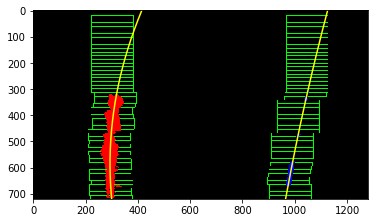

In [27]:
img_road = cv2.imread(test_images[6])
img_road = cv2.cvtColor(img_road, cv2.COLOR_BGR2RGB)
ImgProcessWarped = Image_process_pipeline(img_road)
out_img = fit_polynomial(ImgProcessWarped)
plt.imshow(out_img)

In [28]:

def fit_poly(img_shape, leftx, lefty, rightx, righty):
     ### TO-DO: Fit a second order polynomial to each with np.polyfit() ###
    #if len(leftx) != 0 and len(rightx) != 0:
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, img_shape[0]-1, img_shape[0])
    ### TO-DO: Calc both polynomials using ploty, left_fit and right_fit ###
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    return left_fitx, right_fitx, ploty

def search_around_poly(Binaryimg_road, leftx, lefty, rightx, righty):
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    # The quiz grader expects 100 here, but feel free to tune on your own!
    
    margin = 80

    # Grab activated pixels
    nonzero = Binaryimg_road.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    # Fit a second order polynomial to each using `np.polyfit`
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    ### Now we need to set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### Hint: consider the window areas for the similarly named variables ###
    ### in the previous quiz, but change the windows to our new search area ###
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit new polynomials
    left_fitx, right_fitx, ploty = fit_poly(Binaryimg_road.shape, leftx, lefty, rightx, righty)
    
    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((Binaryimg_road, Binaryimg_road, Binaryimg_road))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
        # Plots the left and right polynomials on the lane lines
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')

    ## End visualization steps ##
    
    return result

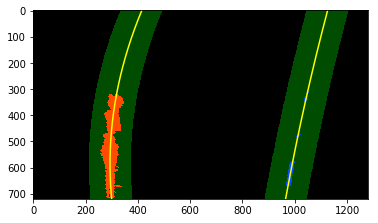

In [29]:
img_road = cv2.imread(test_images[6])
img_road = cv2.cvtColor(img_road, cv2.COLOR_BGR2RGB)
#ImgProcessWarped = Image_process_pipeline(img_road)
# Run image through the pipeline
Binaryimg_road = Image_process_pipeline(img_road)
leftx, lefty, rightx, righty, out_img =  find_lane_pixels(Binaryimg_road) # this is to feed the previous fit
result = search_around_poly(Binaryimg_road, leftx, lefty, rightx, righty)

# View your output
plt.imshow(result)


## Now lets create a pipeline on which returns the complete image with the detected lanes

In [30]:
def LaneFitPipeline(BinaryimgIn, leftx, lefty, rightx, righty):
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    # The quiz grader expects 100 here, but feel free to tune on your own!
   
    margin = 80

    # Grab activated pixels
    nonzero = BinaryimgIn.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    # Fit a second order polynomial to each using `np.polyfit`
    #if len(leftx) != 0 and len(rightx) != 0:
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    ### This is to set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### Hint: consider the window areas for the similarly named variables ###
    ### in the previous quiz, but change the windows to our new search area ###
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit new polynomials
    left_fitx, right_fitx, ploty = fit_poly(BinaryimgIn.shape, leftx, lefty, rightx, righty)
    
    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((BinaryimgIn, BinaryimgIn, BinaryimgIn))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    right_line_window = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    Mid_line_pts = np.hstack((left_line_window, right_line_window))
    # Draw the lane onto the warped blank image
    result = cv2.fillPoly(window_img, np.int_([Mid_line_pts]), (0,255, 0))
    unwarped = inv_perspective_transform(result)
    ## End visualization steps ##
    
    return unwarped

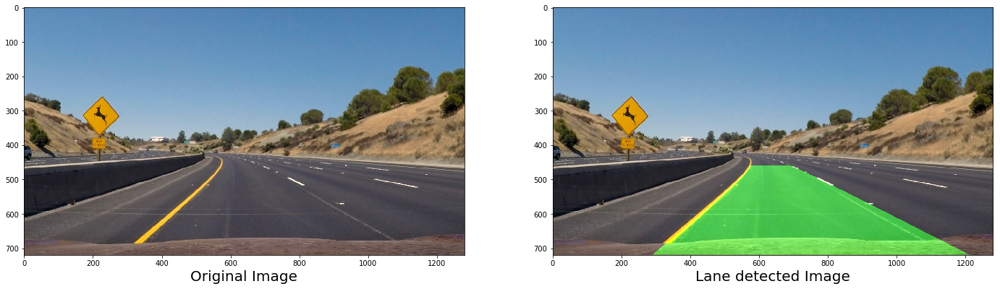

In [31]:
img_road = cv2.imread(test_images[3])
img_road = cv2.cvtColor(img_road, cv2.COLOR_BGR2RGB)
Binaryimg = Image_process_pipeline(img_road)
leftx, lefty, rightx, righty, out_img =  find_lane_pixels(Binaryimg)
unwarped = LaneFitPipeline(Binaryimg, leftx, lefty, rightx, righty)
finalImg= cv2.addWeighted(unwarped, 0.5, img_road, 1, 0)
display_images(img1=img_road, img2=finalImg, cmap = None, label1='Original Image', label2='Lane detected Image', n=2)
#plt.imshow(finalImg)

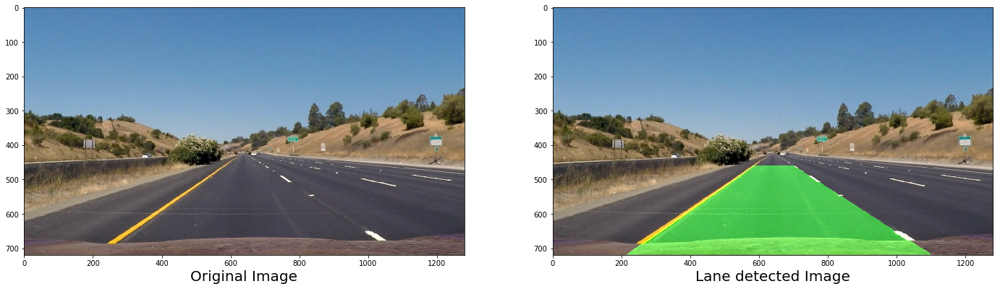

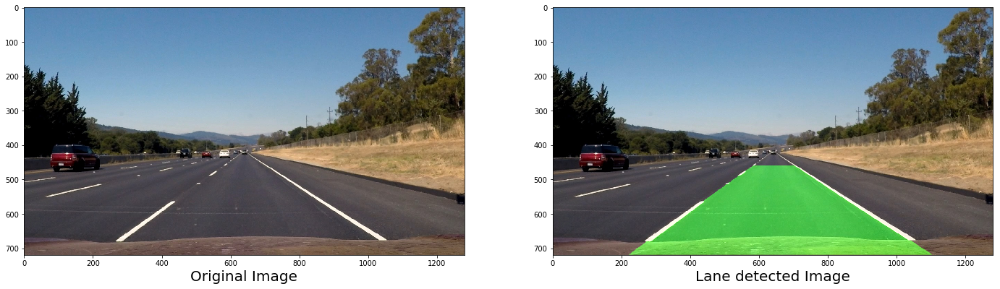

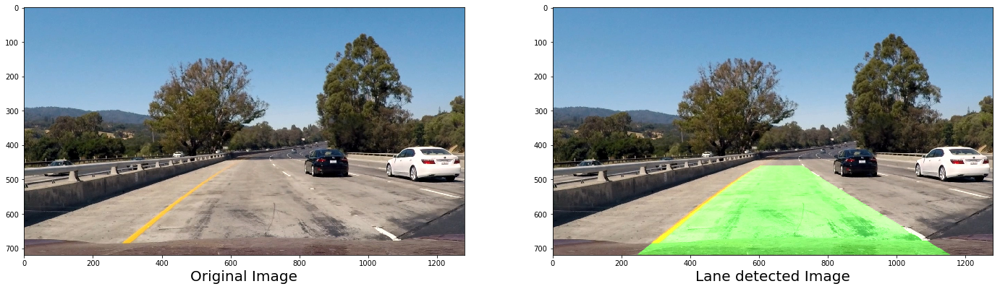

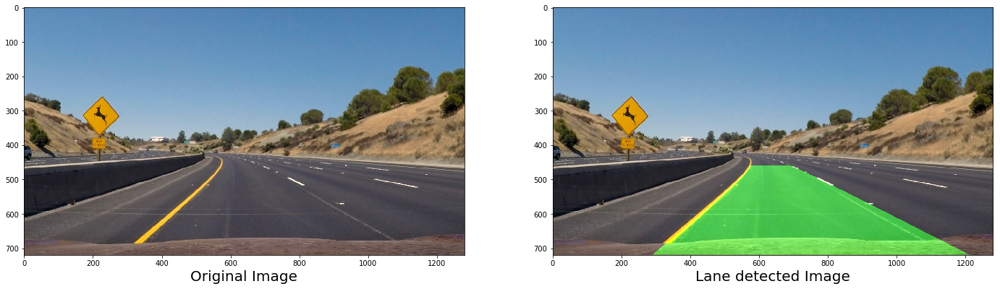

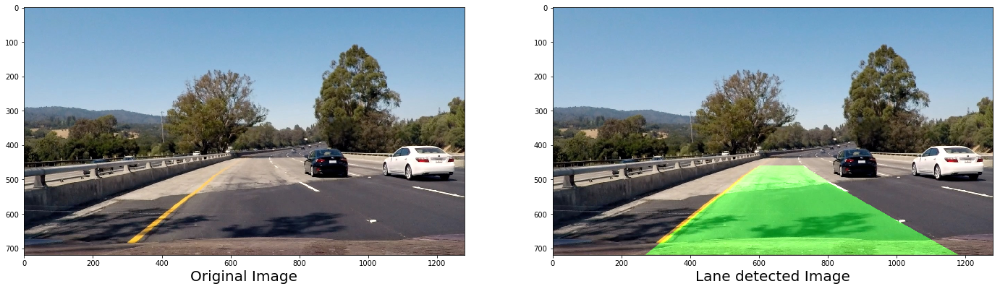

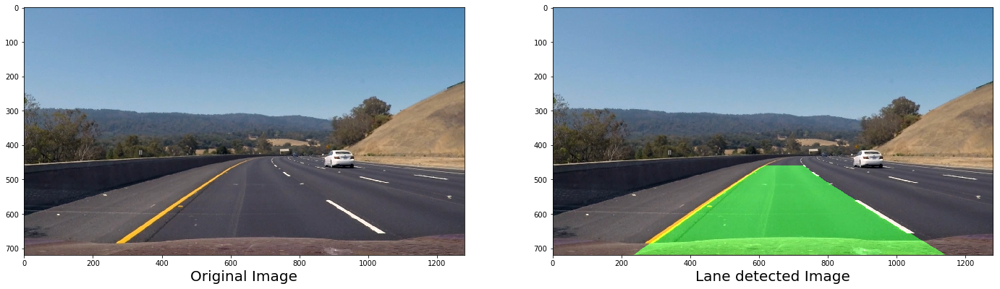

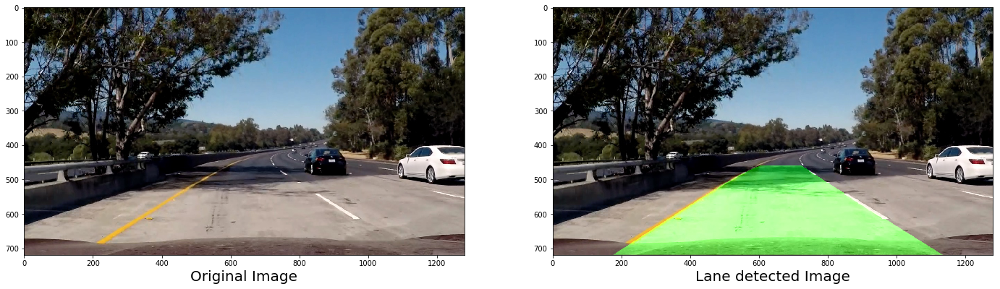

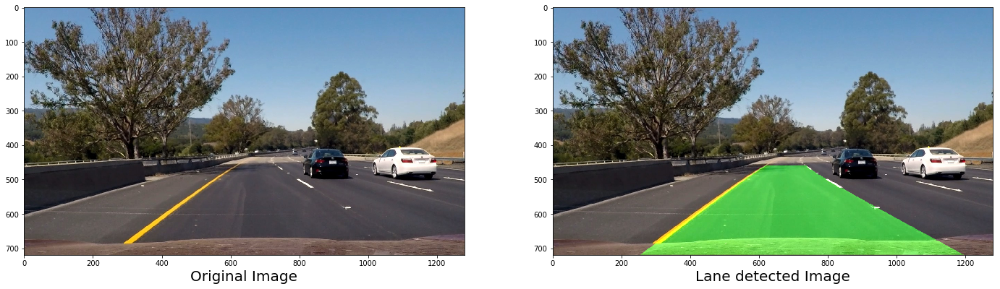

In [32]:
Roadtest_images = glob.glob('test_images/*.jpg')
for file in Roadtest_images:
    img_road = cv2.imread(file)
    img_road = cv2.cvtColor(img_road, cv2.COLOR_BGR2RGB)
    Binaryimg = Image_process_pipeline(img_road)
    leftx, lefty, rightx, righty, out_img =  find_lane_pixels(Binaryimg)
    unwarped = LaneFitPipeline(Binaryimg, leftx, lefty, rightx, righty)
    finalImg= cv2.addWeighted(unwarped, 0.5, img_road, 1, 0)
    display_images(img1=img_road, img2=finalImg, cmap = None, label1='Original Image', label2='Lane detected Image', n=2)
#plt.imshow(finalImg)

## Another Sliding window method

In [ ]:
img_road = cv2.imread(test_images[1])
img_road = cv2.cvtColor(img_road, cv2.COLOR_BGR2RGB)
ImgProcessWarped = Image_process_pipeline(img_road)
# Read in a thresholded image
warped = ImgProcessWarped
# window settings
window_width = 50 
window_height = 80 # Break image into 9 vertical layers since image height is 720
margin = 50 # How much to slide left and right for searching

def window_mask(width, height, img_ref, center,level):
    output = np.zeros_like(img_ref)
    output[int(img_ref.shape[0]-(level+1)*height):int(img_ref.shape[0]-level*height),max(0,int(center-width/2)):min(int(center+width/2),img_ref.shape[1])] = 1
    return output

def find_window_centroids(image, window_width, window_height, margin):
    
    window_centroids = [] # Store the (left,right) window centroid positions per level
    window = np.ones(window_width) # Create our window template that we will use for convolutions
    
    # First find the two starting positions for the left and right lane by using np.sum to get the vertical image slice
    # and then np.convolve the vertical image slice with the window template 
    
    # Sum quarter bottom of image to get slice, could use a different ratio
    l_sum = np.sum(image[int(3*image.shape[0]/4):,:int(image.shape[1]/2)], axis=0)
    l_center = np.argmax(np.convolve(window,l_sum))-window_width/2
    r_sum = np.sum(image[int(3*image.shape[0]/4):,int(image.shape[1]/2):], axis=0)
    r_center = np.argmax(np.convolve(window,r_sum))-window_width/2+int(image.shape[1]/2)

    # Add what we found for the first layer
    window_centroids.append((l_center,r_center))
    
    # Go through each layer looking for max pixel locations
    for level in range(1,(int)(image.shape[0]/window_height)):
	    # convolve the window into the vertical slice of the image
	    image_layer = np.sum(image[int(image.shape[0]-(level+1)*window_height):int(image.shape[0]-level*window_height),:], axis=0)
	    conv_signal = np.convolve(window, image_layer)
	    # Find the best left centroid by using past left center as a reference
	    # Use window_width/2 as offset because convolution signal reference is at right side of window, not center of window
	    offset = window_width/2
	    l_min_index = int(max(l_center+offset-margin,0))
	    l_max_index = int(min(l_center+offset+margin,image.shape[1]))
	    l_center = np.argmax(conv_signal[l_min_index:l_max_index])+l_min_index-offset
	    # Find the best right centroid by using past right center as a reference
	    r_min_index = int(max(r_center+offset-margin,0))
	    r_max_index = int(min(r_center+offset+margin,image.shape[1]))
	    r_center = np.argmax(conv_signal[r_min_index:r_max_index])+r_min_index-offset
	    # Add what we found for that layer
	    window_centroids.append((l_center,r_center))

    return window_centroids

window_centroids = find_window_centroids(warped, window_width, window_height, margin)

# If we found any window centers
if len(window_centroids) > 0:

    # Points used to draw all the left and right windows
    l_points = np.zeros_like(warped)
    r_points = np.zeros_like(warped)

    # Go through each level and draw the windows 	
    for level in range(0,len(window_centroids)):
        # Window_mask is a function to draw window areas
	    l_mask = window_mask(window_width,window_height,warped,window_centroids[level][0],level)
	    r_mask = window_mask(window_width,window_height,warped,window_centroids[level][1],level)
	    # Add graphic points from window mask here to total pixels found 
	    l_points[(l_points == 255) | ((l_mask == 1) ) ] = 255
	    r_points[(r_points == 255) | ((r_mask == 1) ) ] = 255

    # Draw the results
    template = np.array(r_points+l_points,np.uint8) # add both left and right window pixels together
    zero_channel = np.zeros_like(template) # create a zero color channel
    template = np.array(cv2.merge((zero_channel,template,zero_channel)),np.uint8) # make window pixels green
    warpage= np.dstack((warped, warped, warped))*255 # making the original road pixels 3 color channels
    output = cv2.addWeighted(warpage, 1, template, 0.5, 0.0) # overlay the orignal road image with window results
 
# If no window centers found, just display orginal road image
else:
    output = np.array(cv2.merge((warped,warped,warped)),np.uint8)

# Display the final results
plt.imshow(output)
plt.title('window fitting results')
plt.show()


## We proceed further to the calculation of the curvature road so that we know the position of the vehicle 

In [ ]:
def Calc_Curv(BinaryimgIn, InitialImg):
    '''
    Calculates the curvature of polynomial functions in pixels.
    '''
        # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(BinaryimgIn)
    # Generate x and y values for plotting
    ploty = np.linspace(0, BinaryimgIn.shape[0]-1, BinaryimgIn.shape[0] )
    y_eval = np.max(ploty)
    
    
    if len(leftx) != 0 and len(rightx) != 0:
        # Fit new polynomials to x,y in world space
        left_fit = np.polyfit(lefty, leftx, 2)
        right_fit = np.polyfit(righty, rightx, 2)
        left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
        right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
        # Calculate the new radii of curvature
        # Calculation of R_curve (radius of curvature)
        left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
        right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
        AvgCurv = (left_curverad+right_curverad)/2
    if right_fit is not None and left_fit is not None:
            car_position = img.shape[1]/2
            l_fit_x_int = left_fit[0]*BinaryimgIn.shape[0]**2 + left_fit[1]*BinaryimgIn.shape[0] + left_fit[2]
            r_fit_x_int = right_fit[0]*BinaryimgIn.shape[0]**2 + right_fit[1]*BinaryimgIn.shape[0] + right_fit[2]
            lane_center_position = (r_fit_x_int + l_fit_x_int) /2
            center_dist = (car_position - lane_center_position) * xm_per_pix
            #return left_curveRad, right_curveRad, left_curveRad_real, right_curveRad_real
    Final_img = np.copy(InitialImg)
    h = Final_img.shape[0]
    font = cv2.FONT_HERSHEY_TRIPLEX
    text = 'Radius of curvature: %.2f m' % AvgCurv
    cv2.putText(Final_img, text, (40,80), font, 1.0, (255,255,255), 2, cv2.LINE_AA)
    
    abs_center_dist = abs(center_dist)
    if center_dist > 0:
        text = '%.3f m right of center' % abs_center_dist
    elif center_dist < 0:
        text = '%.3f m left of center' % abs_center_dist
    
    cv2.putText(Final_img, text, (40,120), font, 1.0, (255,255,255), 2, cv2.LINE_AA)
    
    return Final_img

In [ ]:
#Pipeline for the complete process including findig the radius of curvature and center position

def LaneFindingPipeline(imgIn):
    Binaryimg = Image_process_pipeline(imgIn)
    leftx, lefty, rightx, righty, out_img =  find_lane_pixels(Binaryimg)
    unwarped = LaneFitPipeline(Binaryimg, leftx, lefty, rightx, righty)
    ## End visualization steps ##
    LaneImg= cv2.addWeighted(unwarped, 0.5, imgIn, 1, 0)
    
    Final_img = Calc_Curv(Binaryimg, LaneImg)

    return Final_img

In [ ]:
Roadtest_images = glob.glob('test_images/*.jpg')
for file in Roadtest_images:
    img_road = cv2.imread(file)
    img_road = cv2.cvtColor(img_road, cv2.COLOR_BGR2RGB)
    ImgProcessWarped = LaneFindingPipeline(img_road)
    display_images(img1=img_road, img2=ImgProcessWarped, cmap = None, label1='Original Image', label2='Lane detected Image', n=2)

In [ ]:
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = []  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #number of detected pixels
        self.px_count = None
    def check_lane(self, fitx, fity):
        if fitx is not None or fity is not None :
            self.detected = False
            
        else:
            self.detected = True
            self.current_fitx.append(fitx)
            self.current_fity.append(fity)
            if len(self.current_fitx) > 4 and len(self.current_fity) > 4 :
                self.current_fitx = self.current_fitx[len(self.current_fitx)-4:]
                self.current_fity = self.current_fity[len(self.current_fity)-4:]
            self.best_fitx = np.average(self.current_fitx, axis=0)
            self.best_fity = np.average(self.current_fity, axis=0)

In [ ]:
Video_output = 'test_image_output/project_video.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4").subclip(0,5)
clip1 = VideoFileClip("project_video.mp4")
white_clip = clip1.fl_image(LaneFindingPipeline) #NOTE: this function expects color images!!
%time white_clip.write_videofile(Video_output, audio=False)

In [ ]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(Video_output))

In [ ]:
ChallengeVideo_output = 'test_image_output/challenge_video.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4").subclip(0,5)
clip1 = VideoFileClip("challenge_video.mp4")
white_clip = clip1.fl_image(LaneFindingPipeline) #NOTE: this function expects color images!!
%time white_clip.write_videofile(ChallengeVideo_output, audio=False)

In [ ]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(ChallengeVideo_output))